In [ ]:
# based on
# https://towardsdatascience.com/deep-convolutional-gan-how-to-use-a-dcgan-to-generate-images-in-python-b08afd4d124e
# https://github.com/yashy3nugu/Anime-Face-GAN/blob/main/DCGAN.ipynb


# Let’s import the libraries:

In [1]:
# Tensorflow / Keras
import tensorflow as tf
from tensorflow import keras # for building Neural Networks
print('Tensorflow/Keras: %s' % keras.__version__) # print version
from keras.models import Sequential # for assembling a Neural Network model
from keras.layers import Activation, Dense, Reshape, Flatten, Conv2D, Conv2DTranspose, ReLU, LeakyReLU, Dropout, BatchNormalization # adding layers to the Neural Network model
from tensorflow.keras.utils import plot_model # for plotting model diagram
from tensorflow.keras.optimizers import Adam # for model optimization 
from keras.optimizers import RMSprop

# Data manipulation
import numpy as np # for data manipulation
print('numpy: %s' % np.__version__) # print version
import sklearn
print('sklearn: %s' % sklearn.__version__) # print version
from sklearn.preprocessing import MinMaxScaler # for scaling inputs used in the generator and discriminator


# Visualization
import cv2 # for ingesting images
print('OpenCV: %s' % cv2.__version__) # print version
import matplotlib 
import matplotlib.pyplot as plt # or data visualizationa
print('matplotlib: %s' % matplotlib.__version__) # print version
import graphviz # for showing model diagram
print('graphviz: %s' % graphviz.__version__) # print version


# Other utilities
import sys
import os

# Assign main directory to a variable
main_dir=os.path.dirname(sys.path[0])

np.random.seed(42)
tf.random.set_seed(42)

Tensorflow/Keras: 2.10.0
numpy: 1.23.2
sklearn: 1.2.1
OpenCV: 4.7.0
matplotlib: 3.6.3
graphviz: 0.20.1


Next, we download, save and ingest Caltech 101 image dataset. We will only use images of bonsai trees (Category = “bonsai”) instead of an entire list of 101 categories. Also, we will set the resolution to (64 x 64) pixels.

In [21]:
# Specify the location of images after you have downloaded them
ImgLocation = main_dir + "/HW32_Myshkavets S.A./images"

# Create a list to store image paths
ImagePaths=[]
for image in list(os.listdir(ImgLocation)):
    if image != '.DS_Store':
        ImagePaths = ImagePaths + [ImgLocation + "/" + image]
        
# Load images and resize to 64 x 64
data_lowres=[]
for img in ImagePaths:
    image = cv2.imread(img)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_lowres = cv2.resize(image, (64, 64))
    data_lowres.append(image_lowres)

# Convert image data to numpy array and standardize values (divide by 255 since RGB values ranges from 0 to 255)
data_lowres = np.array(data_lowres, dtype="float") / 255.0
# data_lowres = (np.array(data_lowres, dtype="float") / 127.5)-1


# Show data shape
print("Shape of data_lowres: ", data_lowres.shape)

[[[255 254 255]
  [253 252 255]
  [251 252 255]
  ...
  [254 255 255]
  [251 255 255]
  [249 255 255]]

 [[254 253 255]
  [252 251 255]
  [253 254 255]
  ...
  [254 255 255]
  [252 255 255]
  [251 255 255]]

 [[254 252 255]
  [254 254 255]
  [252 253 253]
  ...
  [252 255 255]
  [254 255 255]
  [253 255 255]]

 ...

 [[248 255 255]
  [177 196 195]
  [ 71 115 114]
  ...
  [241 255 253]
  [250 255 254]
  [254 255 253]]

 [[245 254 253]
  [193 214 212]
  [ 72 116 116]
  ...
  [234 253 248]
  [251 255 255]
  [253 253 253]]

 [[244 253 252]
  [202 223 221]
  [ 71 115 115]
  ...
  [229 250 245]
  [249 255 255]
  [252 252 252]]]
[[[254 254 249]
  [253 245 253]
  [186 157 193]
  ...
  [ 54  30  66]
  [ 49  30  62]
  [ 65  38  77]]

 [[254 253 253]
  [207 193 211]
  [204 168 211]
  ...
  [ 69  40  80]
  [ 46  23  58]
  [ 65  37  77]]

 [[241 236 245]
  [184 161 190]
  [246 201 252]
  ...
  [ 82  47  95]
  [ 55  27  67]
  [ 62  33  73]]

 ...

 [[252 254 251]
  [248 247 248]
  [245 240 245]
  ..

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[1.         0.99607843 1.        ]
  [0.99215686 0.98823529 1.        ]
  [0.98431373 0.98823529 1.        ]
  ...
  [0.99607843 1.         1.        ]
  [0.98431373 1.         1.        ]
  [0.97647059 1.         1.        ]]

 [[0.99607843 0.99215686 1.        ]
  [0.98823529 0.98431373 1.        ]
  [0.99215686 0.99607843 1.        ]
  ...
  [0.99607843 1.         1.        ]
  [0.98823529 1.         1.        ]
  [0.98431373 1.         1.        ]]

 [[0.99607843 0.98823529 1.        ]
  [0.99607843 0.99607843 1.        ]
  [0.98823529 0.99215686 0.99215686]
  ...
  [0.98823529 1.         1.        ]
  [0.99607843 1.         1.        ]
  [0.99215686 1.         1.        ]]

 ...

 [[0.97254902 1.         1.        ]
  [0.69411765 0.76862745 0.76470588]
  [0.27843137 0.45098039 0.44705882]
  ...
  [0.94509804 1.         0.99215686]
  [0.98039216 1.         0.99607843]
  [0.99607843 1.         0.99215686]]

 [[0.96078431 0.99607843 0.99215686]
  [0.75686275 0.83921569 0.83137255]


[[[0.85882353 0.75294118 0.70980392]
  [0.84705882 0.74509804 0.69411765]
  [0.85098039 0.74901961 0.69803922]
  ...
  [0.87058824 0.78431373 0.72156863]
  [0.81176471 0.70588235 0.63921569]
  [0.81176471 0.69803922 0.63529412]]

 [[0.86666667 0.76078431 0.71764706]
  [0.85490196 0.75294118 0.70196078]
  [0.85882353 0.75686275 0.69803922]
  ...
  [0.82352941 0.76470588 0.69019608]
  [0.85882353 0.77254902 0.69803922]
  [0.78823529 0.68235294 0.61568627]]

 [[0.87058824 0.76078431 0.70980392]
  [0.8627451  0.75294118 0.69803922]
  [0.87058824 0.76470588 0.69019608]
  ...
  [0.43921569 0.43137255 0.33333333]
  [0.69411765 0.63137255 0.55294118]
  [0.77647059 0.69019608 0.61960784]]

 ...

 [[0.26666667 0.40392157 0.54901961]
  [0.32156863 0.45098039 0.58039216]
  [0.29803922 0.40392157 0.51372549]
  ...
  [1.         0.99607843 1.        ]
  [1.         1.         1.        ]
  [1.         1.         1.        ]]

 [[0.42352941 0.52941176 0.62745098]
  [0.5372549  0.63529412 0.7372549 ]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[0.52156863 0.50980392 0.49019608]
  [0.66666667 0.65098039 0.64313725]
  [0.88627451 0.86666667 0.8745098 ]
  ...
  [1.         1.         0.99215686]
  [0.98823529 0.98823529 0.98039216]
  [0.99607843 0.99607843 0.98823529]]

 [[0.55686275 0.54509804 0.52941176]
  [0.65882353 0.64313725 0.63137255]
  [0.89019608 0.8745098  0.88235294]
  ...
  [0.98823529 0.98823529 0.98039216]
  [0.99607843 0.99607843 0.98823529]
  [0.99607843 0.99607843 0.98823529]]

 [[0.55294118 0.5372549  0.5254902 ]
  [0.70588235 0.69019608 0.68627451]
  [0.85098039 0.83137255 0.84313725]
  ...
  [0.98431373 0.98431373 0.97647059]
  [0.99607843 0.99607843 0.98823529]
  [0.99607843 0.99607843 0.98823529]]

 ...

 [[0.57254902 0.56078431 0.58431373]
  [0.64705882 0.63529412 0.6627451 ]
  [0.66666667 0.65490196 0.68235294]
  ...
  [0.37254902 0.36470588 0.38823529]
  [0.49803922 0.49803922 0.50980392]
  [0.45882353 0.45882353 0.47058824]]

 [[0.71372549 0.70196078 0.72941176]
  [0.63921569 0.62745098 0.65490196]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[0.99607843 0.99607843 0.98823529]
  [0.99215686 0.99215686 0.98431373]
  [0.9254902  0.9254902  0.92156863]
  ...
  [1.         0.99215686 0.98431373]
  [0.99607843 0.99607843 1.        ]
  [0.99607843 0.99607843 0.99607843]]

 [[0.98039216 0.98039216 0.96470588]
  [0.92156863 0.91764706 0.90196078]
  [0.83529412 0.83137255 0.81960784]
  ...
  [0.98431373 0.99215686 1.        ]
  [0.98431373 0.98823529 0.98431373]
  [0.98431373 1.         0.98039216]]

 [[0.95294118 0.94509804 0.92941176]
  [0.81176471 0.80784314 0.78823529]
  [0.98039216 0.97647059 0.96078431]
  ...
  [0.76078431 0.78823529 0.8745098 ]
  [0.90196078 0.92156863 0.95686275]
  [0.96078431 0.97647059 0.96470588]]

 ...

 [[0.6745098  0.55686275 0.51372549]
  [0.6627451  0.54117647 0.48627451]
  [0.70588235 0.61176471 0.56470588]
  ...
  [0.98039216 0.94509804 0.93333333]
  [0.91764706 0.84313725 0.84705882]
  [0.6627451  0.56078431 0.58039216]]

 [[0.6        0.48235294 0.43921569]
  [0.70588235 0.58039216 0.53333333]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[0.81960784 0.85882353 0.82745098]
  [0.4627451  0.58823529 0.45098039]
  [0.37647059 0.55294118 0.36078431]
  ...
  [0.36862745 0.37254902 0.38039216]
  [0.50196078 0.48627451 0.50980392]
  [0.42352941 0.37254902 0.45490196]]

 [[0.74509804 0.80392157 0.76470588]
  [0.2627451  0.39607843 0.2745098 ]
  [0.40392157 0.5372549  0.39607843]
  ...
  [0.42745098 0.50980392 0.43529412]
  [0.41176471 0.46666667 0.42352941]
  [0.29411765 0.27843137 0.3254902 ]]

 [[0.41176471 0.50588235 0.44705882]
  [0.20392157 0.31372549 0.23921569]
  [0.28627451 0.3254902  0.27843137]
  ...
  [0.36078431 0.51372549 0.37647059]
  [0.34117647 0.44705882 0.35686275]
  [0.29411765 0.30588235 0.32156863]]

 ...

 [[0.41960784 0.36470588 0.47843137]
  [0.27058824 0.21568627 0.3254902 ]
  [0.22745098 0.15686275 0.28627451]
  ...
  [0.28627451 0.21176471 0.3254902 ]
  [0.34117647 0.27058824 0.37647059]
  [0.58431373 0.52156863 0.61176471]]

 [[0.32941176 0.26666667 0.37254902]
  [0.27058824 0.2        0.29411765]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[0.22352941 0.0627451  0.04705882]
  [0.34509804 0.1254902  0.1254902 ]
  [0.63137255 0.25882353 0.29411765]
  ...
  [0.87058824 0.8745098  0.85882353]
  [0.56078431 0.50196078 0.49411765]
  [0.25882353 0.10196078 0.10588235]]

 [[0.76078431 0.6745098  0.63529412]
  [0.92941176 0.58431373 0.63921569]
  [0.94117647 0.32156863 0.42352941]
  ...
  [0.95686275 0.97254902 0.96862745]
  [0.98039216 0.98039216 0.97254902]
  [0.94117647 0.89411765 0.90196078]]

 [[0.94117647 0.70588235 0.72941176]
  [0.95294118 0.39215686 0.44313725]
  [0.95294118 0.29803922 0.31764706]
  ...
  [0.97254902 0.97254902 0.96470588]
  [0.96470588 0.96470588 0.95686275]
  [0.97647059 0.98039216 0.97254902]]

 ...

 [[0.23921569 0.05490196 0.05098039]
  [0.31764706 0.06666667 0.08235294]
  [0.76862745 0.29803922 0.35686275]
  ...
  [0.5372549  0.03137255 0.00392157]
  [0.58039216 0.05098039 0.02352941]
  [0.43921569 0.02352941 0.00392157]]

 [[0.10980392 0.01960784 0.01960784]
  [0.29803922 0.04313725 0.05098039]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[0.98431373 0.98431373 0.98039216]
  [0.96470588 0.98431373 0.98431373]
  [0.75294118 0.80392157 0.81960784]
  ...
  [0.08627451 0.18431373 0.21176471]
  [0.23137255 0.32941176 0.35294118]
  [0.25098039 0.34901961 0.36862745]]

 [[0.98039216 0.99607843 0.99607843]
  [0.78431373 0.83137255 0.83921569]
  [0.14901961 0.21960784 0.23529412]
  ...
  [0.1372549  0.23529412 0.2627451 ]
  [0.09411765 0.19215686 0.21960784]
  [0.30980392 0.40784314 0.43529412]]

 [[0.56470588 0.62745098 0.63529412]
  [0.34117647 0.41568627 0.43137255]
  [0.33333333 0.43529412 0.45490196]
  ...
  [0.18431373 0.28235294 0.30980392]
  [0.08627451 0.18431373 0.21176471]
  [0.18431373 0.28235294 0.30980392]]

 ...

 [[1.         1.         1.        ]
  [1.         1.         1.        ]
  [1.         1.         1.        ]
  ...
  [0.09411765 0.19215686 0.20784314]
  [0.09019608 0.17254902 0.19215686]
  [0.07058824 0.1372549  0.16470588]]

 [[1.         1.         1.        ]
  [1.         1.         1.        ]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[0.14901961 0.51764706 0.71764706]
  [0.18431373 0.56078431 0.76078431]
  [0.18431373 0.58039216 0.78431373]
  ...
  [0.99215686 1.         0.98823529]
  [0.99215686 1.         0.99607843]
  [0.98823529 1.         1.        ]]

 [[0.10588235 0.4745098  0.67843137]
  [0.14509804 0.52156863 0.7254902 ]
  [0.16470588 0.56078431 0.76862745]
  ...
  [0.98823529 0.99215686 0.98431373]
  [0.98823529 0.99607843 0.99607843]
  [0.98823529 1.         1.        ]]

 [[0.0745098  0.43529412 0.65490196]
  [0.12941176 0.50196078 0.72156863]
  [0.15294118 0.55294118 0.76470588]
  ...
  [0.98823529 0.98823529 0.98431373]
  [0.98431373 0.99215686 0.99215686]
  [0.98039216 0.99607843 0.99607843]]

 ...

 [[1.         1.         1.        ]
  [0.99607843 0.99607843 0.99607843]
  [0.99607843 0.99607843 0.99607843]
  ...
  [0.98823529 0.98431373 0.96078431]
  [0.96862745 0.95294118 0.90588235]
  [0.91764706 0.89803922 0.83921569]]

 [[1.         1.         1.        ]
  [0.99607843 0.99607843 0.99607843]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[0.48627451 0.6745098  0.60392157]
  [0.25098039 0.43921569 0.36862745]
  [0.5254902  0.71764706 0.64313725]
  ...
  [0.27058824 0.47058824 0.39607843]
  [0.29019608 0.49019608 0.41568627]
  [0.27843137 0.47843137 0.40392157]]

 [[0.25490196 0.43921569 0.36862745]
  [0.49019608 0.67843137 0.60392157]
  [0.52941176 0.72156863 0.64705882]
  ...
  [0.28627451 0.48627451 0.41176471]
  [0.29411765 0.49411765 0.41960784]
  [0.28235294 0.48235294 0.40784314]]

 [[0.40392157 0.59607843 0.52156863]
  [0.56470588 0.75686275 0.68235294]
  [0.47058824 0.66666667 0.59215686]
  ...
  [0.29803922 0.49803922 0.42352941]
  [0.29803922 0.49803922 0.42352941]
  [0.29019608 0.49019608 0.41568627]]

 ...

 [[0.98431373 1.         1.        ]
  [0.96862745 1.         0.99607843]
  [0.88627451 0.94901961 0.9372549 ]
  ...
  [0.32941176 0.44705882 0.4       ]
  [0.14901961 0.25098039 0.21960784]
  [0.44705882 0.54901961 0.51372549]]

 [[0.98823529 1.         1.        ]
  [0.96470588 1.         0.99607843]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[0.8745098  0.64705882 0.42352941]
  [0.80784314 0.63137255 0.39607843]
  [0.69411765 0.57647059 0.34117647]
  ...
  [0.54901961 0.36862745 0.26666667]
  [0.30196078 0.20784314 0.19215686]
  [0.27843137 0.20784314 0.23921569]]

 [[0.87058824 0.65882353 0.44313725]
  [0.77254902 0.60784314 0.38431373]
  [0.97254902 0.87058824 0.64313725]
  ...
  [0.81176471 0.60784314 0.48235294]
  [0.38823529 0.27843137 0.23529412]
  [0.27843137 0.21568627 0.23137255]]

 [[0.80392157 0.62352941 0.41960784]
  [0.90588235 0.76862745 0.56078431]
  [0.94901961 0.8627451  0.65098039]
  ...
  [0.84705882 0.60392157 0.44705882]
  [0.44705882 0.30196078 0.21176471]
  [0.30196078 0.22352941 0.22745098]]

 ...

 [[0.8745098  0.70196078 0.47843137]
  [0.97647059 0.82745098 0.61960784]
  [0.77254902 0.60784314 0.41960784]
  ...
  [0.82745098 0.83137255 0.84705882]
  [0.65490196 0.67058824 0.6745098 ]
  [0.94509804 0.94117647 0.96470588]]

 [[0.8627451  0.68627451 0.44705882]
  [0.97647059 0.82352941 0.58823529]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



The above code prints the shape of our data, which is [samples, rows, columns, channels].

Let’s display a few low-res images to see what we will train our models on.

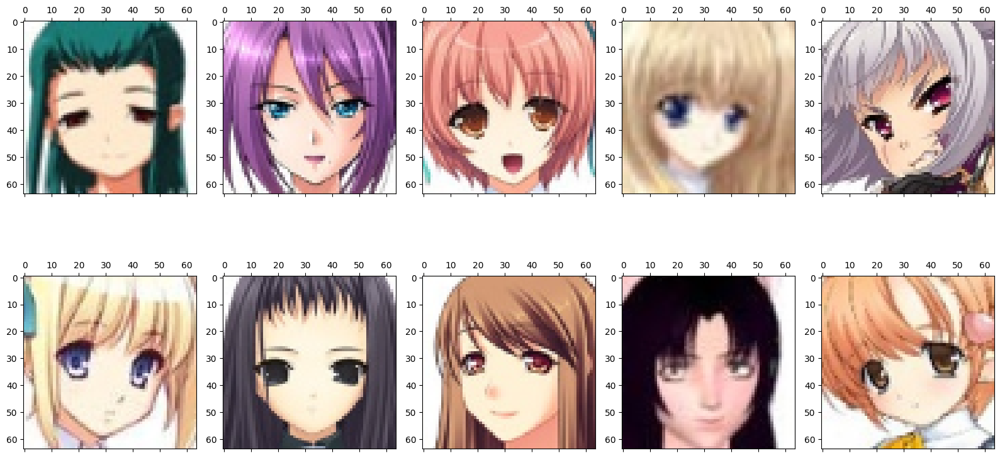

In [3]:
# Display 10 real images
fig, axs = plt.subplots(2, 5, sharey=False, tight_layout=True, figsize=(16,9), facecolor='white')
n=0
for i in range(0,2):
    for j in range(0,5):
        axs[i,j].matshow(data_lowres[n])
        n=n+1
plt.show() 

Finally, let’s scale our image input data which currently has a range of [0,1], to a range of [-1,1]. We do this, so we can use the tanh activation function in the Generator output as it often produces better results.

However, using a sigmoid activation function in the Generator output is also common, which would not require you to rescale images further.

In [4]:
# Scaler
scaler=MinMaxScaler(feature_range=(-1, 1))

# Select images that we want to use for model trainng
data=data_lowres.copy()
print("Original shape of the data: ", data.shape)

# Reshape array
data=data.reshape(-1, 1)
print("Reshaped data: ", data.shape)

# Fit the scaler
scaler.fit(data)

# Scale the array
data=scaler.transform(data)

# Reshape back to the original shape
data=data.reshape(data_lowres.shape[0], 64, 64, 3)
print("Shape of the scaled array: ", data.shape)

Original shape of the data:  (63565, 64, 64, 3)
Reshaped data:  (781086720, 1)
Shape of the scaled array:  (63565, 64, 64, 3)


# Creating a DCGAN model

With data preparation completed, let’s define and assemble our models. We will start with the Generator:

In [5]:
batch_size = 128
seed_size = 128
image_length = 64
image_channels = 3

In [6]:
# Weights initializer
init = tf.keras.initializers.RandomNormal(stddev=0.02)

In [7]:
def generator(seed_size):
    model = Sequential(name="Generator") # Model
  
    # Block - 1
    model.add(Dense(4*4*1024,input_dim=seed_size, kernel_initializer=init))
    model.add(BatchNormalization())
    model.add(ReLU())
    model.add(Reshape((4,4,1024))) # Resulting shape = (4,4,1024) 

    # Block - 2
    model.add(Conv2DTranspose(512,kernel_size=5,strides=2, padding='same',use_bias=False))
    model.add(BatchNormalization())
    model.add(ReLU())  # Resulting shape = (8,8,512)

    # Block - 3
    model.add(Conv2DTranspose(256,kernel_size=5,strides=2, padding='same',use_bias=False))
    model.add(BatchNormalization())
    model.add(ReLU()) # Resulting shape = (16,16,256)

    # Block - 4
    model.add(Conv2DTranspose(128,kernel_size=3,strides=2, padding='same',use_bias=False))
    model.add(BatchNormalization())
    model.add(ReLU()) # Resulting shape = (32,32,128)

    # Block - 5
    model.add(Conv2DTranspose(3,activation='tanh', kernel_size=3,strides=2, padding='same',use_bias=False))

    return model
    
# Instantiate
# latent_dim = 100 # Our latent space has 100 dimensions. We can change it to any number
gen_model = generator(seed_size)

Metal device set to: Apple M1 Pro


2023-04-05 16:08:08.130167: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-04-05 16:08:08.131115: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [8]:
# Show model summary and plot model diagram
gen_model.summary()

Model: "Generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 16384)             2113536   
                                                                 
 batch_normalization (BatchN  (None, 16384)            65536     
 ormalization)                                                   
                                                                 
 re_lu (ReLU)                (None, 16384)             0         
                                                                 
 reshape (Reshape)           (None, 4, 4, 1024)        0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 8, 8, 512)        13107200  
 nspose)                                                         
                                                                 
 batch_normalization_1 (Batc  (None, 8, 8, 512)        20

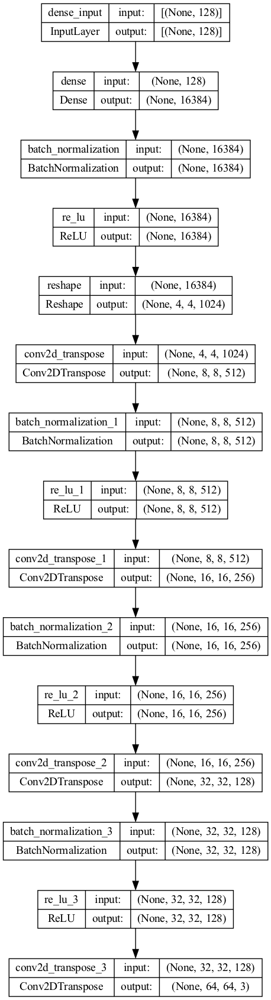

In [9]:
# Plot model diagram
plot_model(gen_model, show_shapes=True, show_layer_names=True, dpi=100)

We start with a 100-node latent vector, which we connect to the 8192-node Dense layer before reshaping it to 8 x 8 x 128. Then we pass it through Transposed Convolutions to upsample the data to a 64 x 64 output.

Note that we also use regular Convolution in the output layer as we reduce filters from 512 to only 3, representing different colour channels.

Next, let’s define a Discriminator model:

In [10]:
def discriminator(image_length,image_channels):
    model = Sequential(name="Discriminator") # Model
  
    # Block - 1
    model.add(Conv2D(64,kernel_size=3,strides=2,padding='same',use_bias=False, kernel_initializer=init, input_shape=(image_length,image_length,image_channels)))
    model.add(LeakyReLU(alpha=0.2)) # Resulting shape = (32,32,64)

    # Block - 2
    model.add(Conv2D(128,kernel_size=3,strides=2,padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2)) # Resulting shape = (16,16,128)

    # Block - 3
    model.add(Conv2D(256,kernel_size=5,strides=2,padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2)) # Resulting shape = (8,8,256)

    # Block - 4
    model.add(Conv2D(512,kernel_size=5,strides=2,padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2)) # Resulting shape = (4,4,512)

    # Block - 5
    model.add(Conv2D(1,kernel_size=4,strides=1,padding='valid', use_bias=False))
    model.add(Flatten())
    model.add(Activation('sigmoid'))
    optimizer = Adam(
        learning_rate=.0002,
        beta_1=0.5)
    model.compile(optimizer=optimizer,
        loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Instantiate
dis_model = discriminator(image_length,image_channels)

/opt/homebrew/Caskroom/miniforge/base/envs/tf_mac/lib/python3.9/site-packages/keras/initializers/initializers_v2.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.
  warnings.warn(


In [11]:
# Show model summary and plot model diagram
dis_model.summary()

Model: "Discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 32, 32, 64)        1728      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 128)       73728     
                                                                 
 batch_normalization_4 (Batc  (None, 16, 16, 128)      512       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 conv2d_2 (Conv2D)           (None, 8, 8, 256)         819200    
                                                     

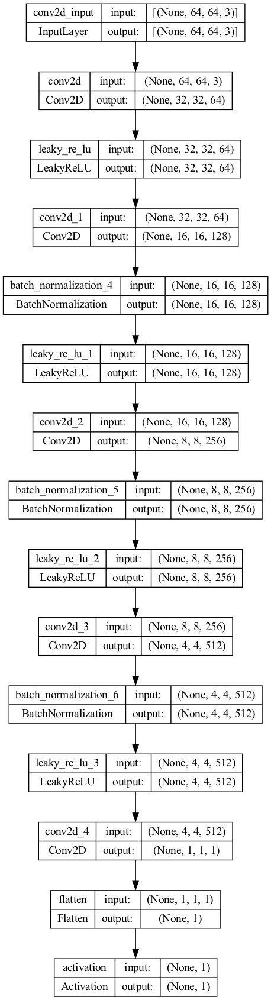

In [12]:
# Plot model diagram
plot_model(dis_model, show_shapes=True, show_layer_names=True, dpi=100)

If you compare it to the Generator model, you will notice that the Discriminator model does the opposite. I.e., it takes a 64 x 64 image and passes it through multiple Convolutional layers to reduce it to a binary classification output of real/fake.

Next, we combine the two models to create a DCGAN. One crucial detail in the code below is that we make the Discriminator model non-trainable. We do this because we want to train the Discriminator separately using a combination of real and fake (generated) data. You will see how we do that later.

In [13]:
def def_gan(generator, discriminator):
    
    # We don't want to train the weights of discriminator at this stage. Hence, make it not trainable
    discriminator.trainable = False
    
    # Combine
    model = Sequential(name="DCGAN") # GAN Model
    model.add(generator) # Add Generator
    model.add(discriminator) # Add Disriminator
    
    # Compile the model
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0002, beta_1=0.5))
#     optimizer = RMSprop(learning_rate=.0001, 
# #                         clipvalue=1.0, 
# #                         decay=1e-8
#                        )
#     model.compile(loss='binary_crossentropy', optimizer=optimizer)
    return model

# Instantiate
gan_model = def_gan(gen_model, dis_model)

In [14]:
# Show model summary and plot model diagram
gan_model.summary()

Model: "DCGAN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Generator (Sequential)      (None, 64, 64, 3)         18865024  
                                                                 
 Discriminator (Sequential)  (None, 1)                 4183232   
                                                                 
Total params: 23,048,256
Trainable params: 18,830,464
Non-trainable params: 4,217,792
_________________________________________________________________


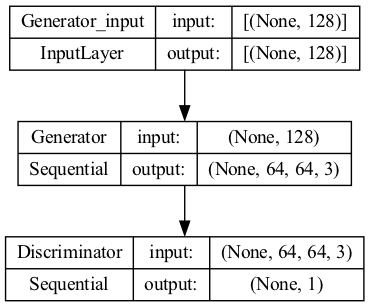

In [15]:
# Plot model diagram
plot_model(gan_model, show_shapes=True, show_layer_names=True, dpi=100)

# Preparing inputs for the Generator and the Discriminator

We will create three simple functions that will aid us in sampling / generating data for the two models.

The first one samples real images from the training data, the second draws random vectors from the latent space, and the third passes latent variables into a Generator model to generate fake examples.

In [16]:
def real_samples(n, dataset):
    
    # Samples of real data
    X = dataset[np.random.choice(dataset.shape[0], n, replace=True), :]

    # Class labels
    y = np.ones((n, 1))
    return X, y
    
    
# def latent_vector(latent_dim, n):
    
#     # Generate points in the latent space
#     latent_input = np.random.randn(latent_dim * n)
    
#     # Reshape into a batch of inputs for the network
#     latent_input = latent_input.reshape(n, latent_dim)
#     print(latent_input.shape)
#     return latent_input

def latent_vector(latent_dim, n):
    
    # Generate points in the latent space
    latent_input = np.random.randn(seed_size*n)
    
#     # Reshape into a batch of inputs for the network
    latent_input = latent_input.reshape(n, seed_size)
    return latent_input
  
    
# def fake_samples(generator, latent_dim, n):
    
#     # Generate points in latent space
#     latent_output = latent_vector(latent_dim, n)
    
#     # Predict outputs (i.e., generate fake samples)
#     X = generator.predict(latent_output)
    
#     # Create class labels
#     y = np.zeros((n, 1))
#     return X, y    

def fake_samples(generator, seed_size, n):
    
    # Generate points in latent space
    latent_output = latent_vector(seed_size, n)
    
    # Predict outputs (i.e., generate fake samples)
    X = generator.predict(latent_output)
    
    # Create class labels
    y = np.zeros((n, 1))
    return X, y 

# Model training and evaluation

The final two functions will help us train the models and evaluate results at specified intervals.

Let’s create the model performance evaluation function first:

In [17]:
def performance_summary(generator, discriminator, dataset, latent_dim, n=50):
    
    # Get samples of the real data
    x_real, y_real = real_samples(n, dataset)
    # Evaluate the descriminator on real data
    _, real_accuracy = discriminator.evaluate(x_real, y_real, verbose=0)
    
    # Get fake (generated) samples
    x_fake, y_fake = fake_samples(generator, latent_dim, n)
    # Evaluate the descriminator on fake (generated) data
    _, fake_accuracy = discriminator.evaluate(x_fake, y_fake, verbose=0)
    
    # summarize discriminator performance
    print("*** Evaluation ***")
    print("Discriminator Accuracy on REAL images: ", real_accuracy)
    print("Discriminator Accuracy on FAKE (generated) images: ", fake_accuracy)
    
    # Display 6 fake images
    x_fake_inv_trans=x_fake.reshape(-1, 1)
    x_fake_inv_trans=scaler.inverse_transform(x_fake_inv_trans)
    x_fake_inv_trans=x_fake_inv_trans.reshape(n, 64, 64, 3)
    
    fig, axs = plt.subplots(2, 3, sharey=False, tight_layout=True, figsize=(12,6), facecolor='white')
    k=0
    for i in range(0,2):
        for j in range(0,3):
            axs[i,j].matshow(x_fake_inv_trans[k])
            k=k+1
    plt.show() 

As you can see, the above function evaluates the Discriminator separately on real and fake (generated) points. Also, it shows a few model-generated images.

Note that to display fake (generated) images, we need to inverse transform the underlying data from the [-1,1] range to the [0,1] range.

Finally, the training function:

In [18]:
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=2001, n_batch=128, n_eval=100):
    
    # Our batch to train the discriminator will consist of half real images and half fake (generated) images
    half_batch = int(n_batch / 2)
    
    # We will manually enumare epochs 
    for i in range(n_epochs):
    
    # Discriminator training
        # Prep real samples
        x_real, y_real = real_samples(half_batch, dataset)
        # Prep fake (generated) samples
        x_fake, y_fake = fake_samples(g_model, latent_dim, half_batch)
        
        # Train the discriminator using real and fake samples
        X, y = np.vstack((x_real, x_fake)), np.vstack((y_real, y_fake))
        discriminator_loss, _ = d_model.train_on_batch(X, y)
    
    # Generator training
        # Get values from the latent space to be used as inputs for the generator
        x_gan = latent_vector(latent_dim, n_batch)
        # While we are generating fake samples, 
        # we want GAN generator model to create examples that resemble the real ones,
        # hence we want to pass labels corresponding to real samples, i.e. y=1, not 0.
        y_gan = np.ones((n_batch, 1))
        
        # Train the generator via a composite GAN model
        generator_loss = gan_model.train_on_batch(x_gan, y_gan)
        
        # Evaluate the model at every n_eval epochs
        if (i) % n_eval == 0:
            print("Epoch number: ", i)
            print("*** Training ***")
            print("Discriminator Loss ", discriminator_loss)
            print("Generator Loss: ", generator_loss)
            performance_summary(g_model, d_model, dataset, latent_dim)

As mentioned earlier, we train the Discriminator separately by passing a batch with 50% real and 50% fake (generated) samples. Meanwhile, the Generator training happens via a combined DCGAN model.

# Results

Let’s call the training function to train the model and display some results.

2/2 [==============================] - 0s 32ms/step


2023-04-05 16:08:09.417521: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-04-05 16:08:09.468836: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-04-05 16:08:09.801787: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-04-05 16:08:10.328616: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Epoch number:  0
*** Training ***
Discriminator Loss  0.6104763150215149
Generator Loss:  0.6391707062721252


2023-04-05 16:08:10.903470: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-04-05 16:08:11.077734: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


2/2 [==============================] - 0s 74ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  0.0


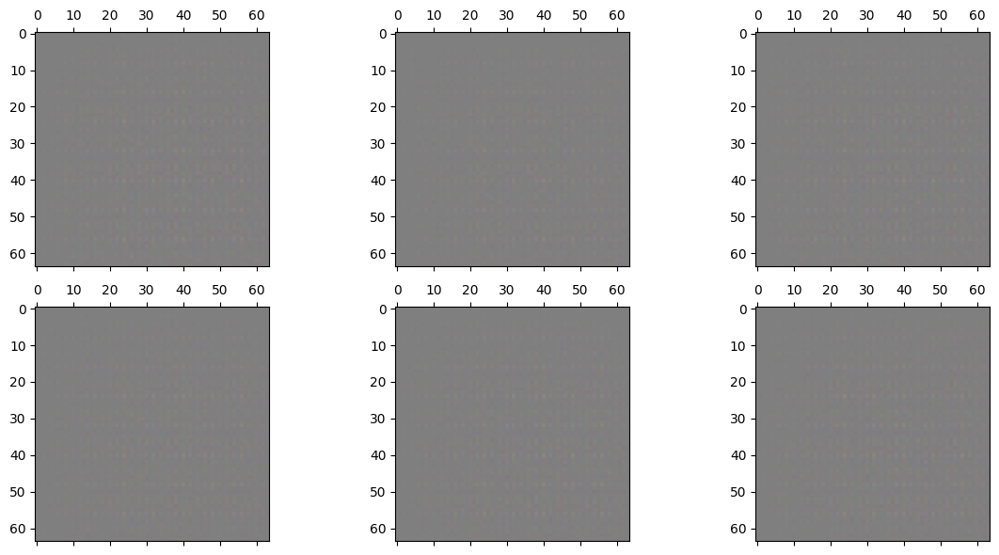

2/2 [==============================] - 0s 51ms/step
Epoch number:  100
*** Training ***
Discriminator Loss  0.011503326706588268
Generator Loss:  2.450368881225586
2/2 [==============================] - 0s 49ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.0
Discriminator Accuracy on FAKE (generated) images:  1.0


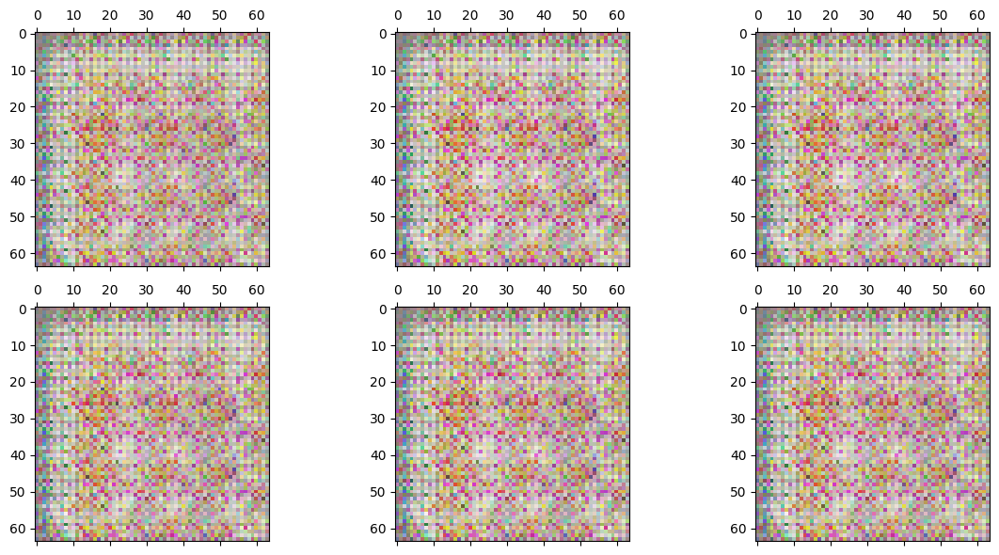

2/2 [==============================] - 0s 48ms/step
Epoch number:  200
*** Training ***
Discriminator Loss  0.0855901688337326
Generator Loss:  5.712588310241699
2/2 [==============================] - 0s 47ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.14000000059604645
Discriminator Accuracy on FAKE (generated) images:  1.0


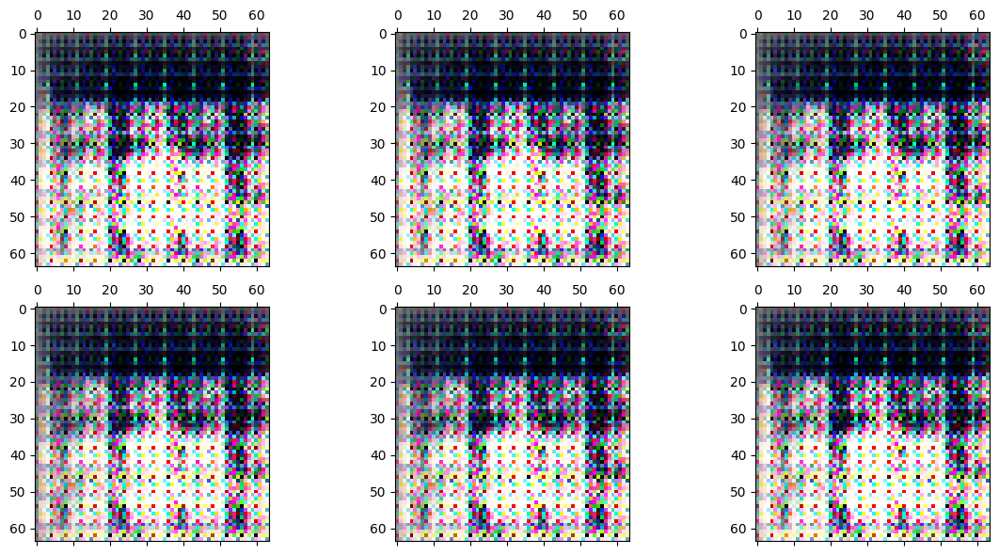

2/2 [==============================] - 0s 48ms/step
Epoch number:  300
*** Training ***
Discriminator Loss  0.04263469949364662
Generator Loss:  8.686330795288086
2/2 [==============================] - 0s 49ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.0
Discriminator Accuracy on FAKE (generated) images:  1.0


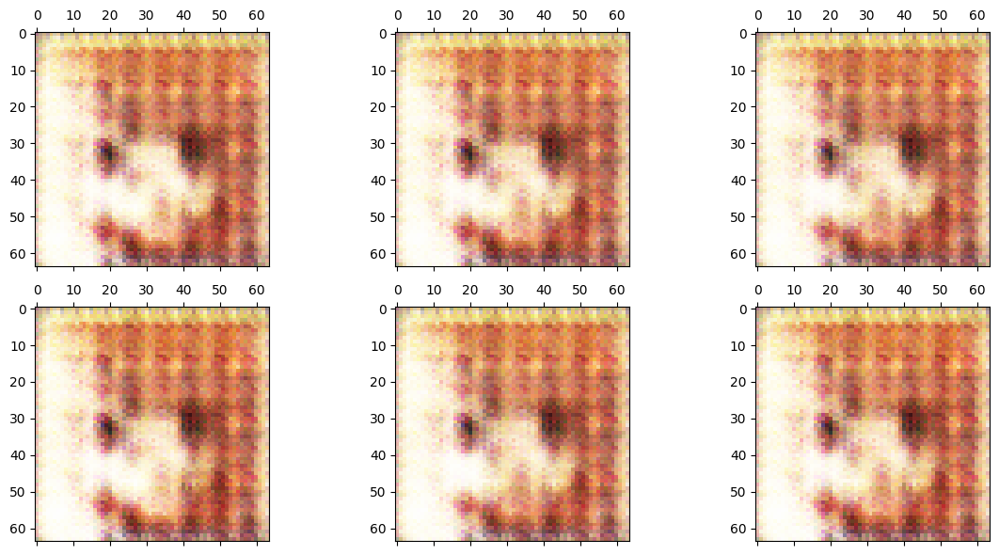

2/2 [==============================] - 0s 48ms/step
Epoch number:  400
*** Training ***
Discriminator Loss  0.0019080000929534435
Generator Loss:  3.051257848739624
2/2 [==============================] - 0s 48ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.05999999865889549
Discriminator Accuracy on FAKE (generated) images:  1.0


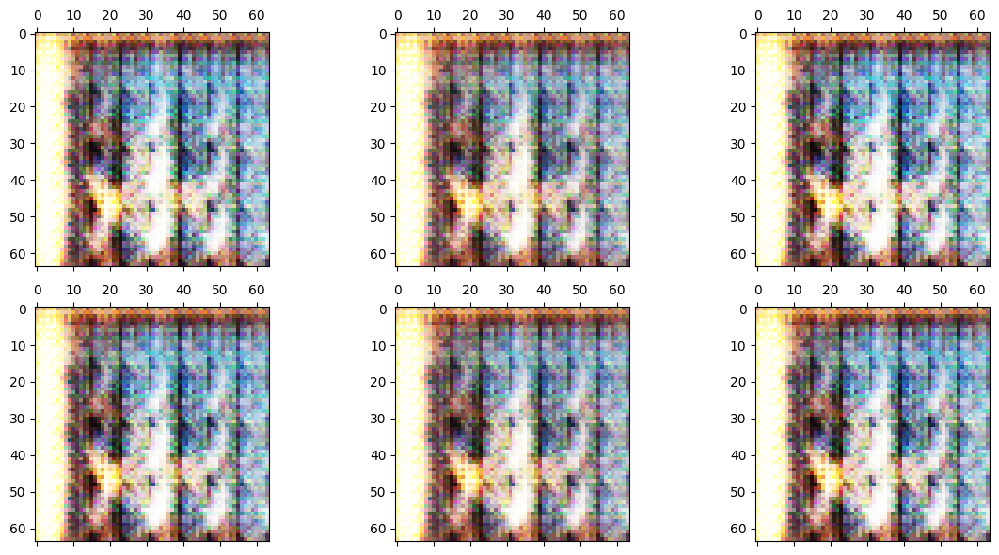

2/2 [==============================] - 0s 51ms/step
Epoch number:  500
*** Training ***
Discriminator Loss  4.759928197017871e-05
Generator Loss:  0.0024802768602967262
2/2 [==============================] - 0s 49ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5199999809265137
Discriminator Accuracy on FAKE (generated) images:  1.0


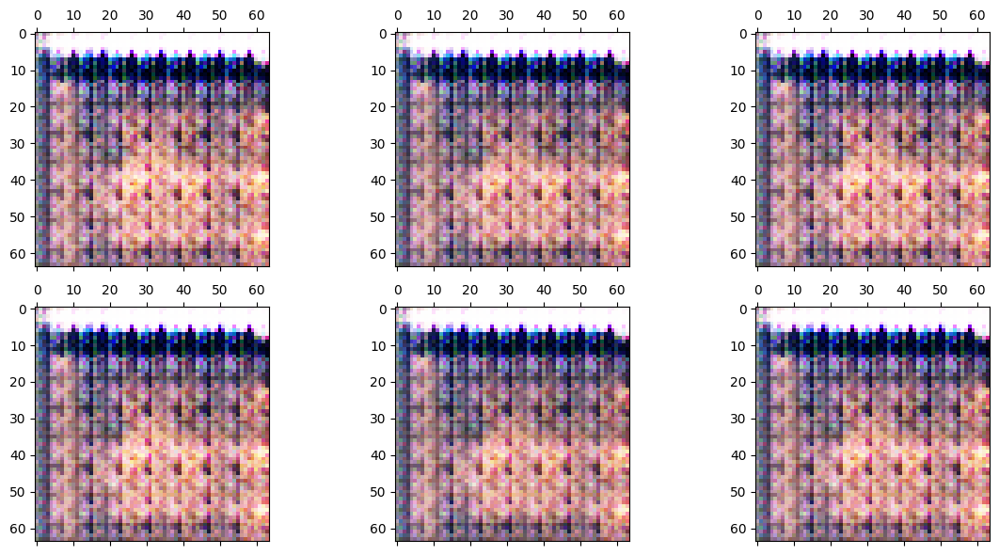

2/2 [==============================] - 0s 48ms/step
Epoch number:  600
*** Training ***
Discriminator Loss  0.00011146032920805737
Generator Loss:  0.0009702640818431973
2/2 [==============================] - 0s 48ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  0.0


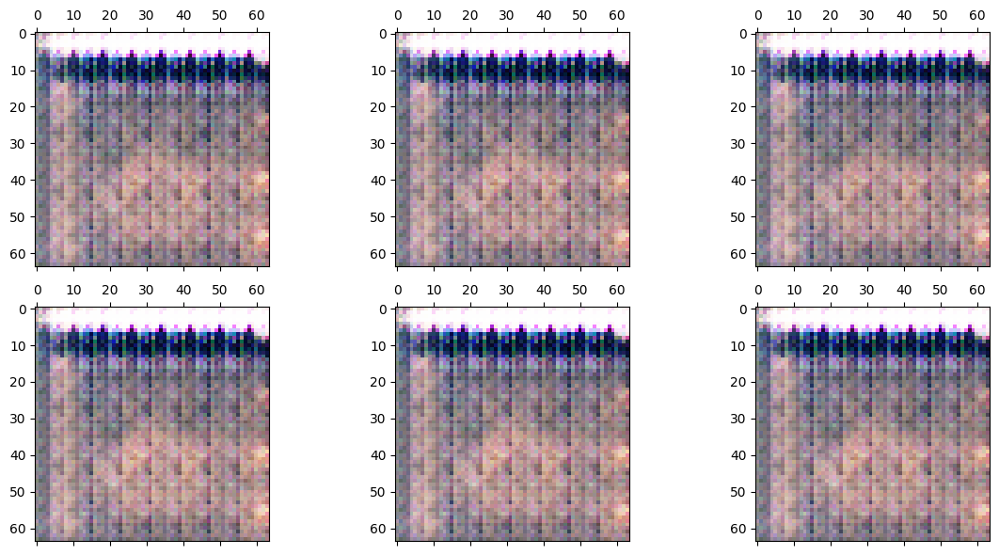

2/2 [==============================] - 0s 48ms/step
Epoch number:  700
*** Training ***
Discriminator Loss  0.00019035078003071249
Generator Loss:  0.0019884281791746616
2/2 [==============================] - 0s 48ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  0.0


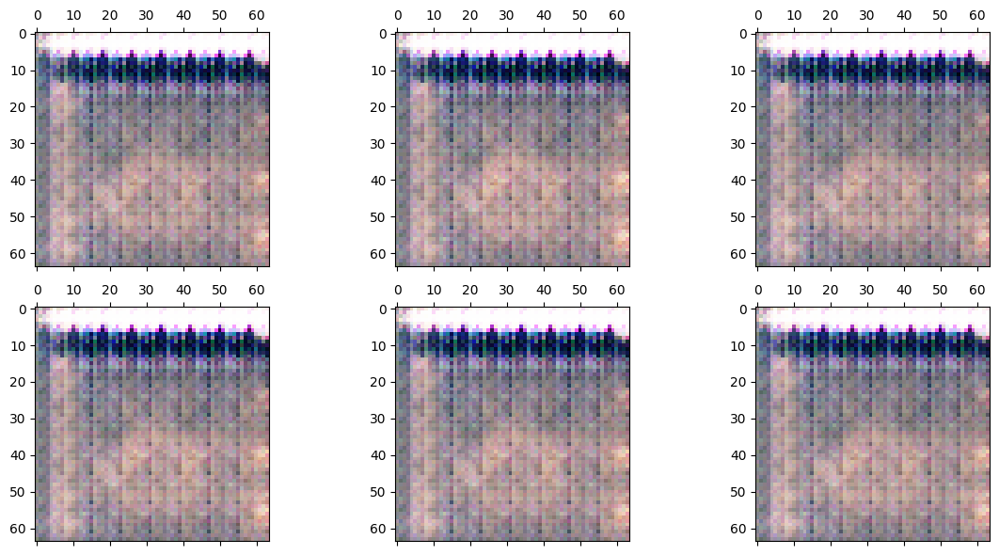

2/2 [==============================] - 0s 48ms/step
Epoch number:  800
*** Training ***
Discriminator Loss  0.0002612163661979139
Generator Loss:  0.0021300707012414932
2/2 [==============================] - 0s 48ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  0.0


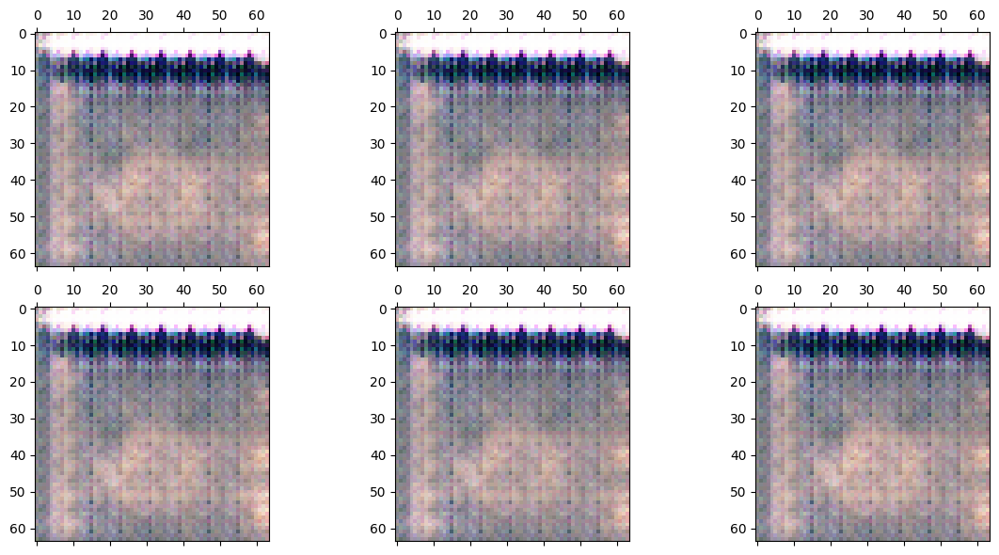

2/2 [==============================] - 0s 48ms/step
Epoch number:  900
*** Training ***
Discriminator Loss  0.0001706253970041871
Generator Loss:  0.0018419109983369708
2/2 [==============================] - 0s 49ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  0.0


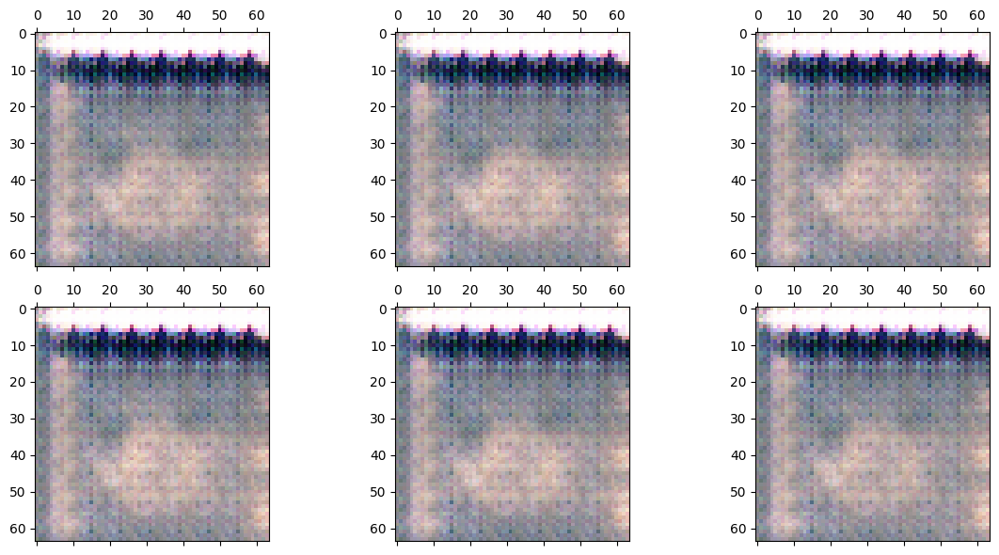

2/2 [==============================] - 0s 48ms/step
Epoch number:  1000
*** Training ***
Discriminator Loss  0.00024351014872081578
Generator Loss:  0.0020615034736692905
2/2 [==============================] - 0s 50ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  0.0


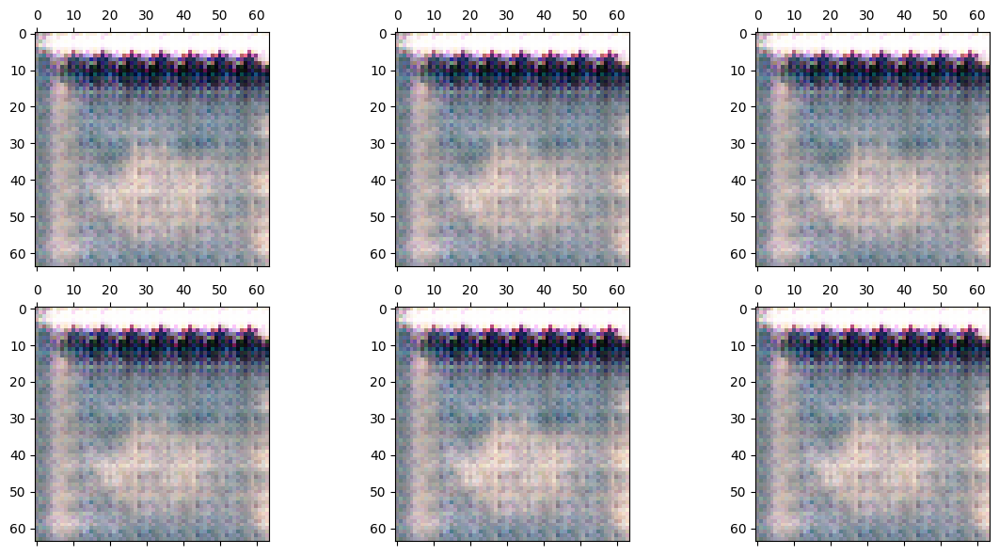

2/2 [==============================] - 0s 48ms/step
Epoch number:  1100
*** Training ***
Discriminator Loss  0.00013543179375119507
Generator Loss:  0.0031145066022872925
2/2 [==============================] - 0s 48ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  0.1599999964237213


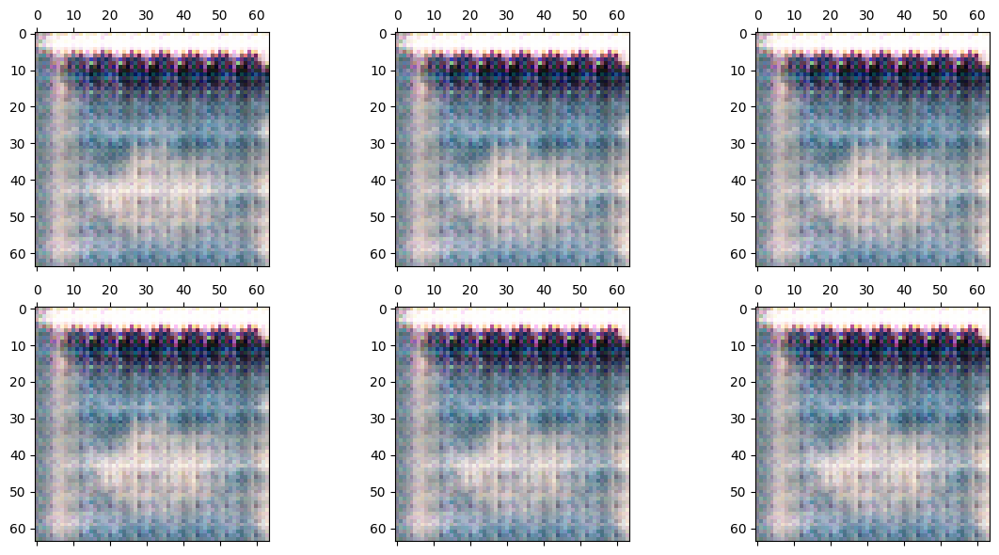

2/2 [==============================] - 0s 48ms/step
Epoch number:  1200
*** Training ***
Discriminator Loss  0.001129505573771894
Generator Loss:  0.00525481766089797
2/2 [==============================] - 0s 48ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  1.0
Discriminator Accuracy on FAKE (generated) images:  1.0


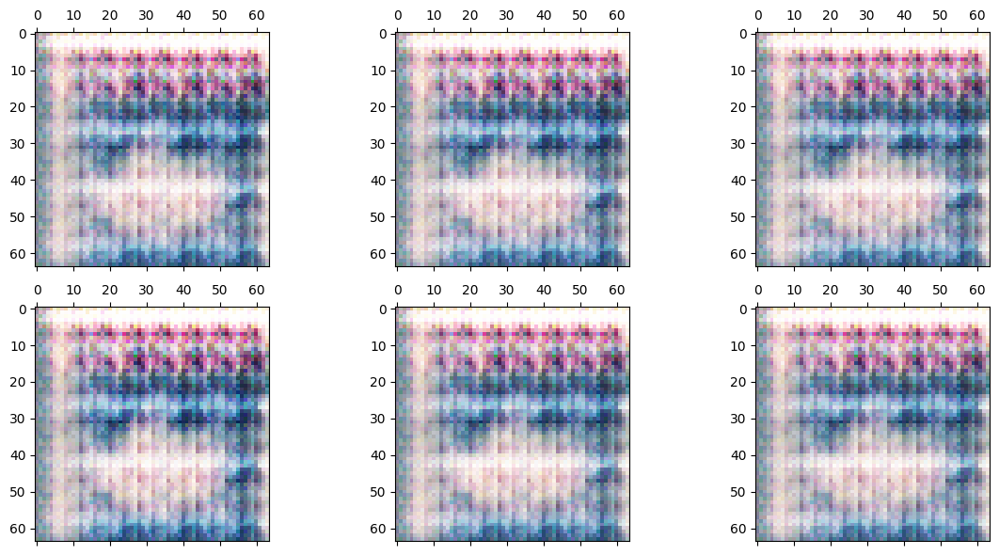

2/2 [==============================] - 0s 47ms/step
Epoch number:  1300
*** Training ***
Discriminator Loss  0.006080294959247112
Generator Loss:  0.024712655693292618
2/2 [==============================] - 0s 47ms/step
*** Evaluation ***
Discriminator Accuracy on REAL images:  0.5600000023841858
Discriminator Accuracy on FAKE (generated) images:  1.0


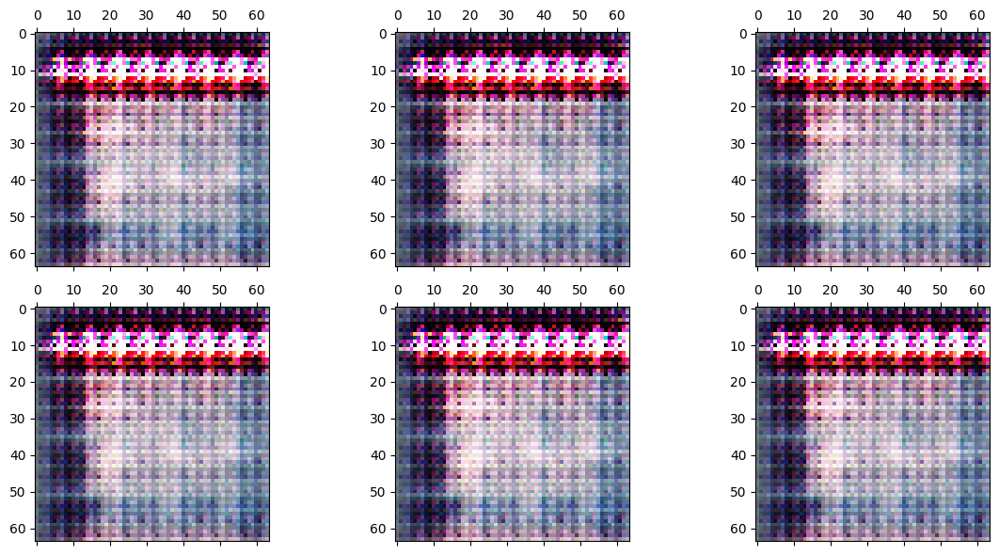

2/2 [==============================] - 0s 48ms/step


KeyboardInterrupt: 

In [19]:
# Train DCGAN model
train(gen_model, dis_model, gan_model, data, seed_size)

As you can see, some of the images are terrible, while others look kind of artsy. However, it’s pretty clear that more training is required.